In [4]:
import pandas as pd

# Load the data from the provided CSV file
round_day_data = [
    {
        "trade_file_path":'backtest_data/trades_round_1_day_-2_wn.csv',
        "price_file_path":'backtest_data/prices_round_1_day_-2.csv',
        "round": 1,
        "day": -2
    },
    {
        "trade_file_path":'backtest_data/trades_round_1_day_-1_wn.csv', 
        "price_file_path":'backtest_data/prices_round_1_day_-1.csv',
        "round": 1,
        "day": -1
    },
    {
        "trade_file_path":'backtest_data/trades_round_1_day_0_wn.csv',
        "price_file_path":'backtest_data/prices_round_1_day_0.csv',
        "round": 1,
        "day": 0
    },
    {
        "trade_file_path":'backtest_data/trades_round_3_day_0_wn.csv', 
        "price_file_path":'backtest_data/prices_round_3_day_0.csv',
        "round": 3,
        "day": 0
    },
    {
        "trade_file_path":'backtest_data/trades_round_3_day_1_wn.csv', 
        "price_file_path":'backtest_data/prices_round_3_day_1.csv',
        "round": 3,
        "day": 1
    },
    {
        "trade_file_path":'backtest_data/trades_round_3_day_2_wn.csv', 
        "price_file_path":'backtest_data/prices_round_3_day_2.csv',
        "round": 3,
        "day": 2
    },
    {
        "trade_file_path":'backtest_data/trades_round_4_day_1_wn.csv',
        "price_file_path":'backtest_data/prices_round_4_day_1.csv', 
        "round": 4,
        "day": 1
    },
    {
        "trade_file_path":'backtest_data/trades_round_4_day_2_wn.csv', 
        "price_file_path":'backtest_data/prices_round_4_day_2.csv',
        "round": 4,
        "day": 2
    },
    {
        "trade_file_path":'backtest_data/trades_round_4_day_3_wn.csv', 
        "price_file_path":'backtest_data/prices_round_4_day_3.csv',
        "round": 4,
        "day": 3
    },
]


trade_data = []
price_data = []
for day_data in round_day_data:
    df = pd.read_csv(day_data['trade_file_path'], delimiter=';')
    df['day'] = day_data['day']
    trade_data.append(df)

    price_data.append(pd.read_csv(day_data['price_file_path'], delimiter=';'))

trade_data_df = pd.concat(trade_data)
price_data_df = pd.concat(price_data)

people = set(trade_data_df['buyer'].unique()).union(set(trade_data_df['seller'].unique()))
products = set(price_data_df['product'].unique())
days = set(price_data_df['day'].unique())
print(people)


{'Ruby', 'Vladimir', 'Raj', 'Remy', 'Vinnie', 'Valentina', 'Adam', 'Amelia', 'Rhianna'}


/var/folders/mn/5d4xhd512lqgmxd3kg1brr0h0000gn/T/ipykernel_33206/1388079641.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 12), sharex=True)


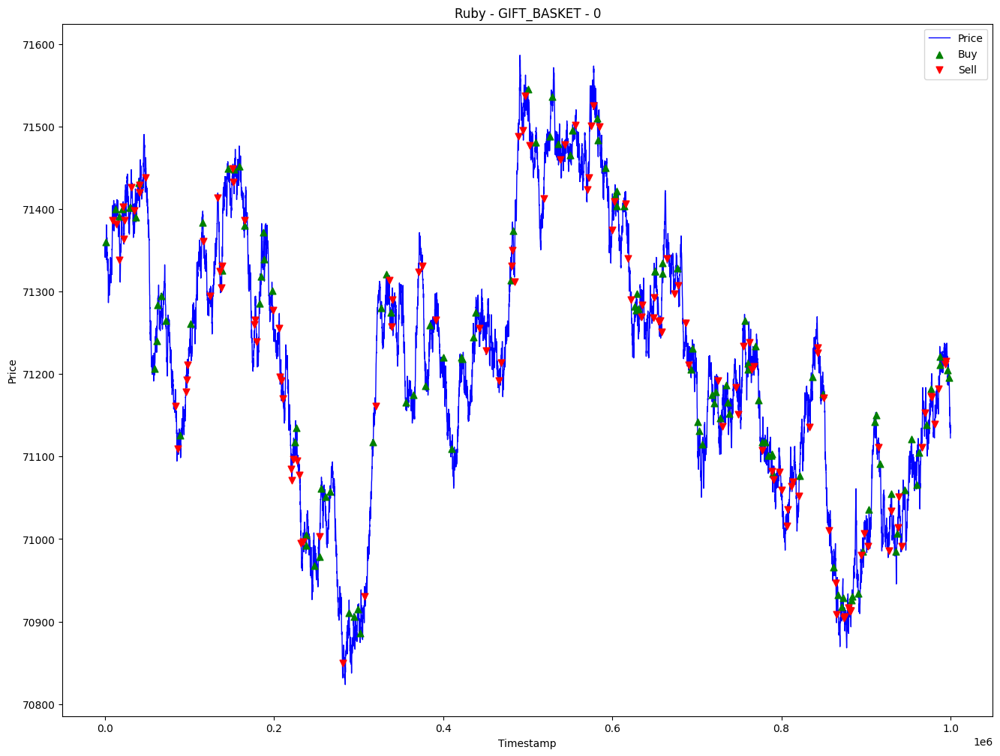

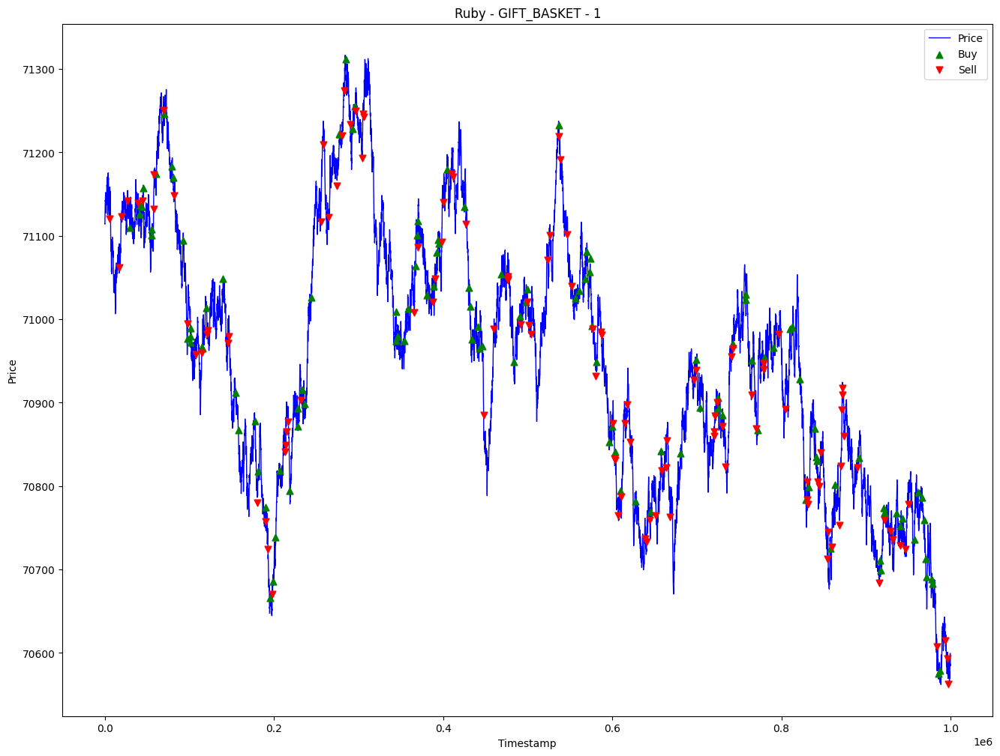

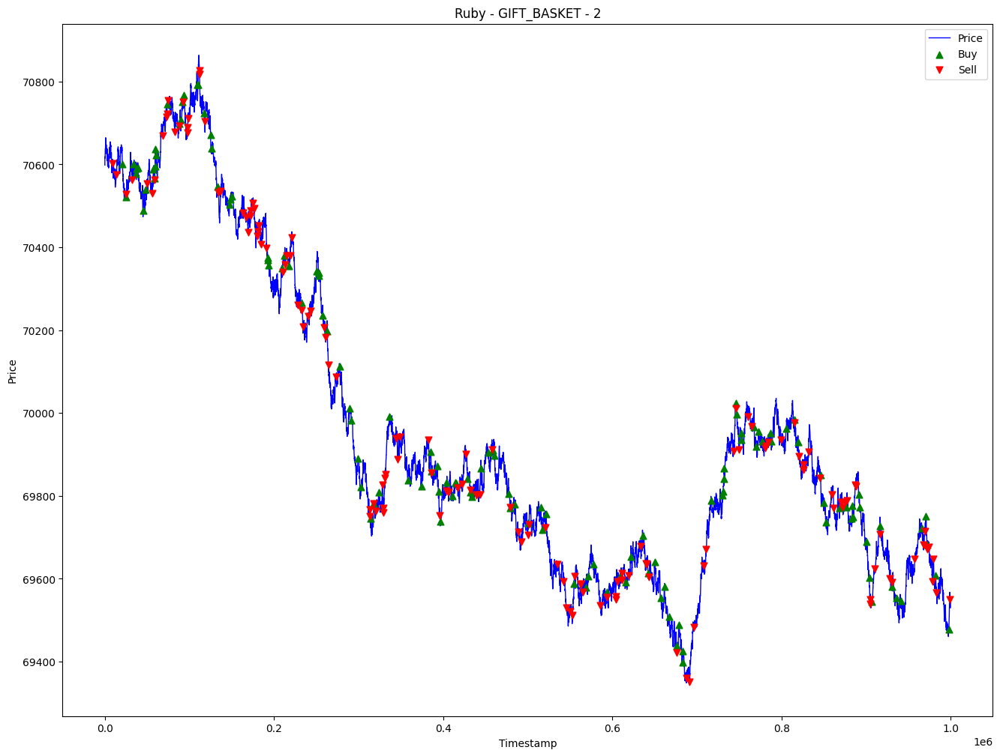

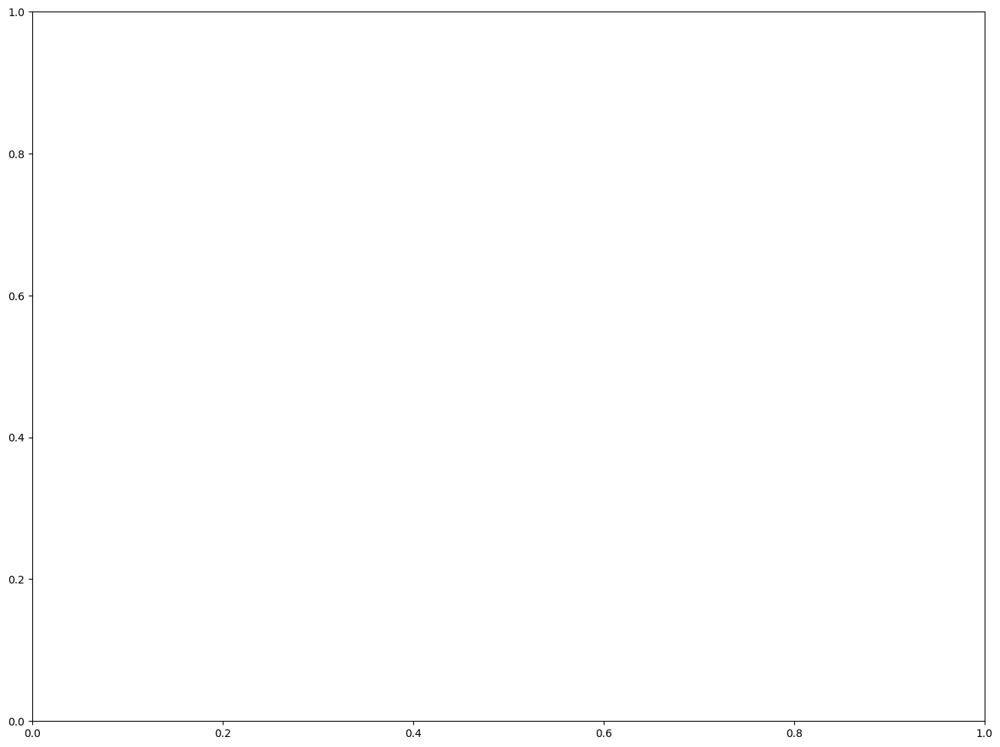

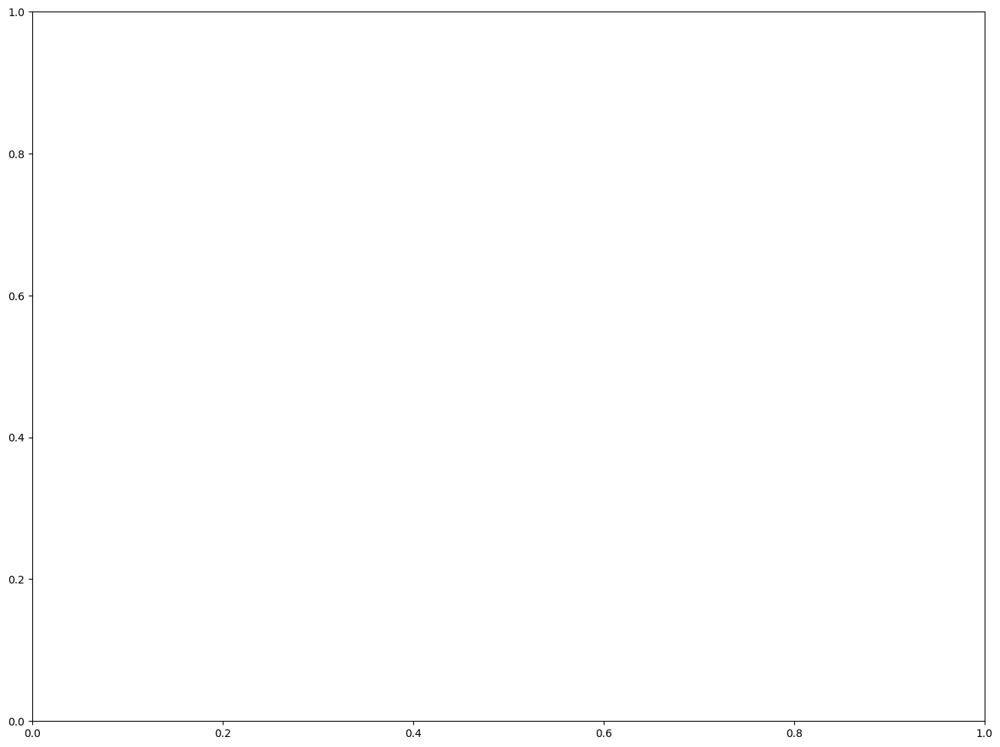

...

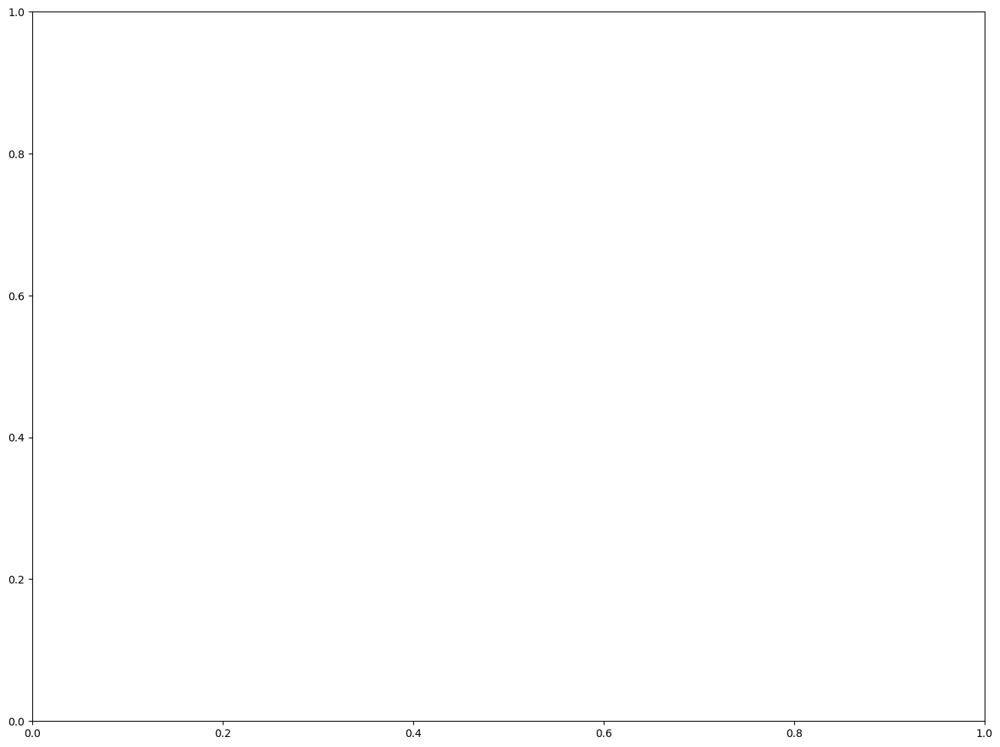

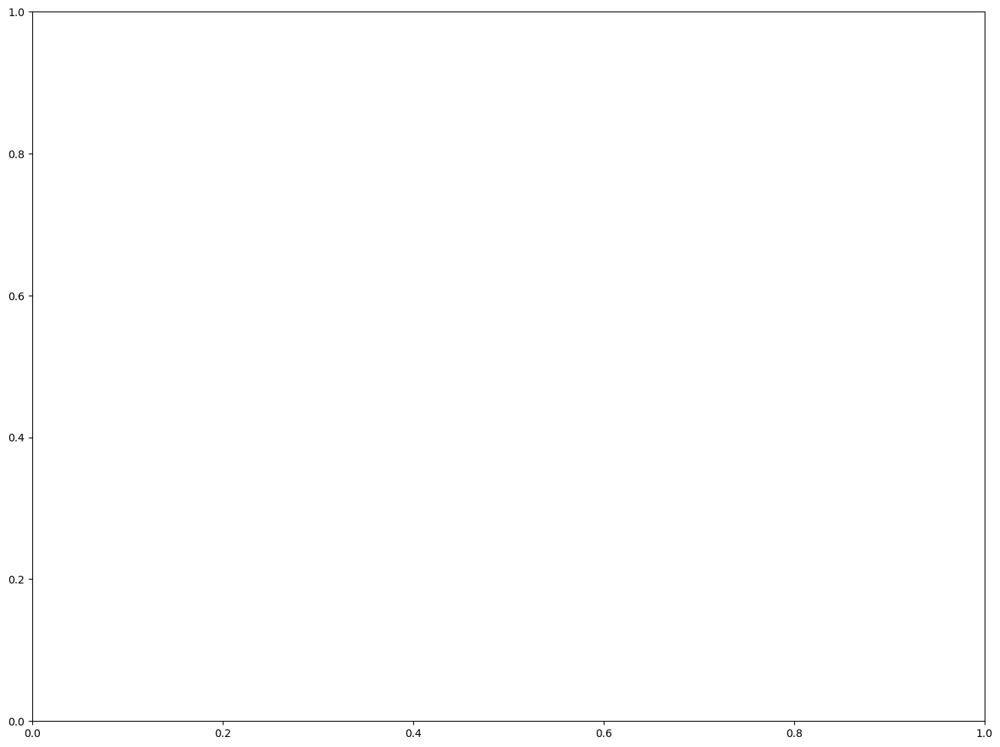

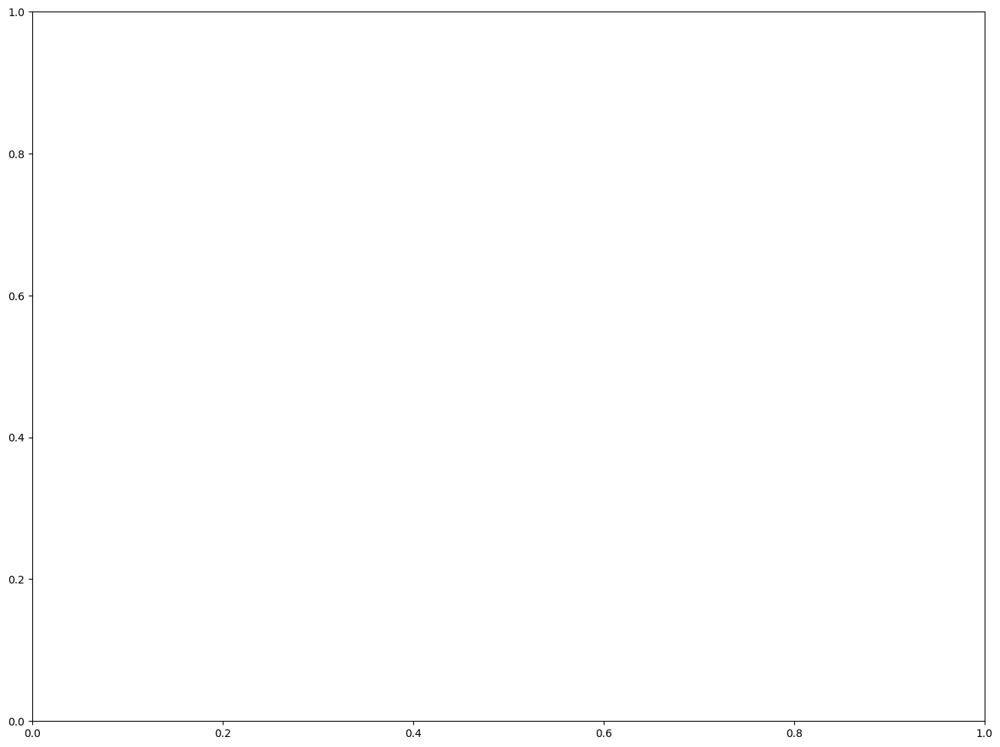

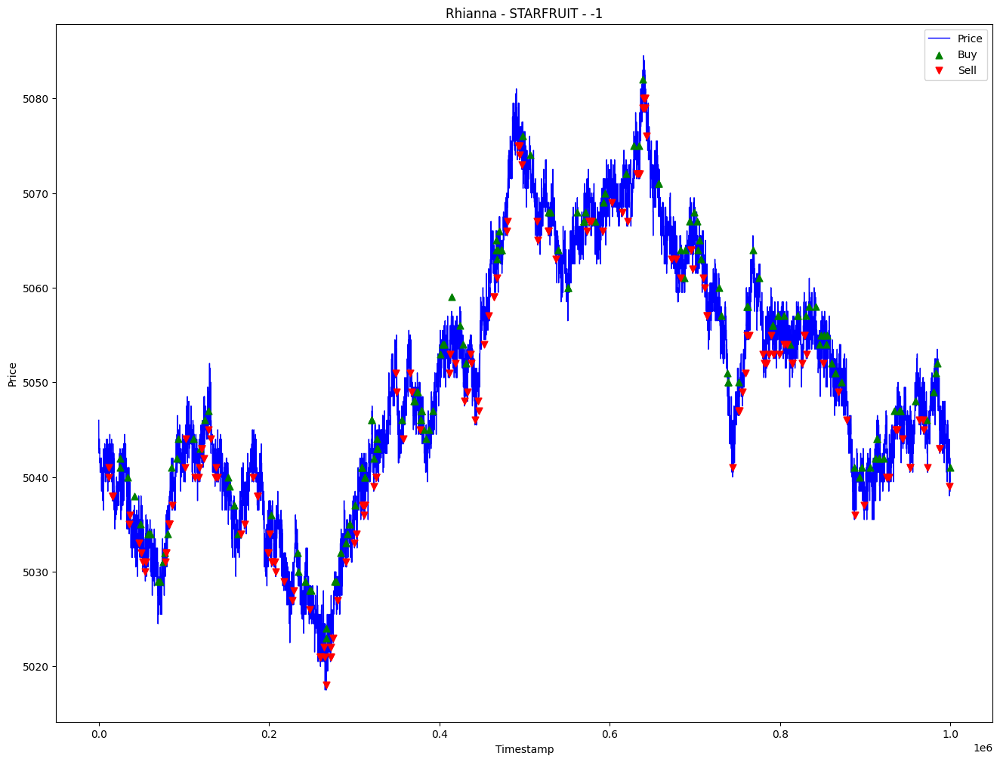

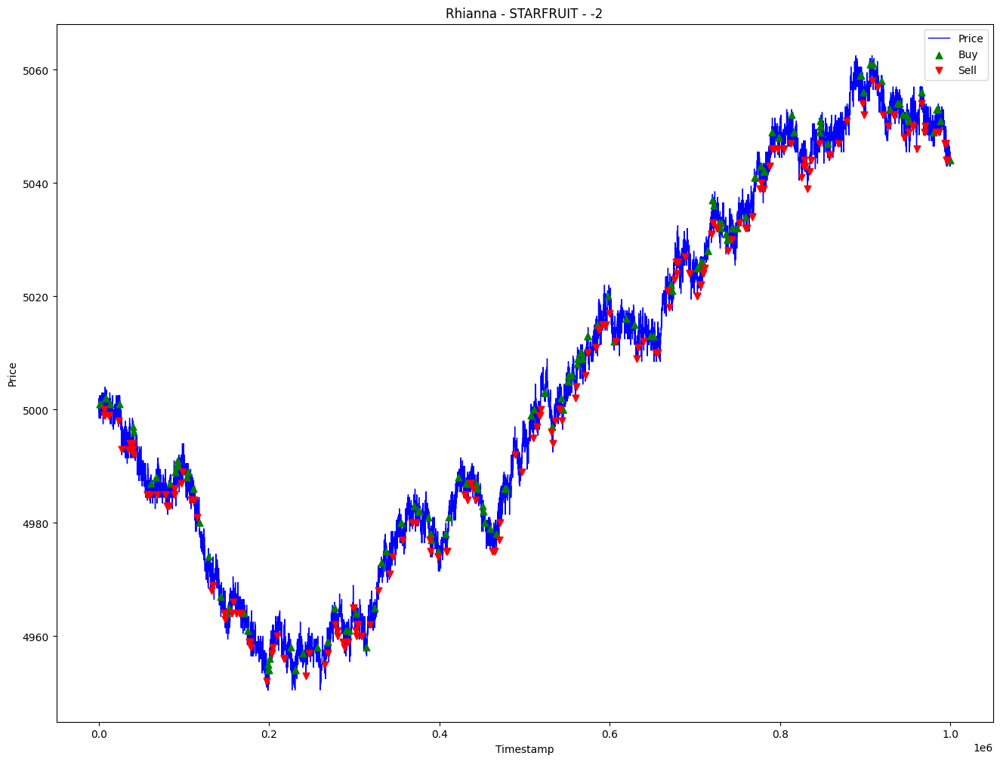

In [5]:
# %matplotlib qt 

import matplotlib.pyplot as plt


# Plotting function with arrows
for i, product in enumerate(products):
    for i, person in enumerate(people):
        for i, day in enumerate(days):

            product_pride_data = price_data_df[(price_data_df["product"] == product) & (price_data_df["day"] == day)]
            if product_pride_data.empty:
                continue

            buying_data = trade_data_df[(trade_data_df["buyer"] == person) & (trade_data_df["symbol"] == product) & (trade_data_df["day"] == day)]
            selling_data = trade_data_df[(trade_data_df["seller"] == person) & (trade_data_df["symbol"] == product) & (trade_data_df["day"] == day)]
            if buying_data.empty and selling_data.empty:
                continue

            fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 12), sharex=True)

            ax.plot(product_pride_data["timestamp"], product_pride_data["mid_price"], label="Price", color="blue", linewidth=1, zorder=1)
            ax.scatter(buying_data["timestamp"], buying_data["price"], color="green", label="Buy", marker="^", s=40, zorder=2)
            ax.scatter(selling_data["timestamp"], selling_data["price"], color="red", label="Sell", marker="v", s=40, zorder=2)

            # Set plot title and labels
            ax.set_title(f"{person} - {product} - {day}")
            ax.set_xlabel("Timestamp")
            ax.set_ylabel("Price")
            ax.legend()

            plt.savefig(f"resources/plots/{person}-{product}-{day}.png")

